---
title: Macaque HiC
date: last-modified
author: Kasper Munch

---

%load_ext autoreload
%autoreload 2

In [74]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
from collections import OrderedDict
from IPython.display import Markdown

import os, subprocess

%matplotlib inline
%config InlineBackend.figure_format='svg'
# %config InlineBackend.figure_format='retina'

from genominterv.decorators import bootstrap
from genominterv.stats import proximity_stat, jaccard_stat

from scipy.stats import fisher_exact

import geneinfo.plot as gplt
import geneinfo.information as gi
import geneinfo.utils as utils
# utils.clear_cache()
# utils.disable_cache = True
from geneinfo.utils import GeneListCollection
from geneinfo.utils import GeneList as glist

from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

import umap
import umap.plot
import pywt

# Import python package for working with cooler files and tools for analysis
import cooler
import cooltools.lib.plotting
# had to add this to _register_colormaps in /Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/cooltools/lib/plotting.py
# from matplotlib.colors import ListedColormap
# mpl.colormaps.register(ListedColormap(pal/255), name=name)
# mpl.colormaps.register(ListedColormap(pal[::-1]/255), name=name + "_r")
import cooltools
import bioframe
import pandas as pd
import os.path as op

import warnings
warnings.simplefilter(action='ignore', category=UserWarning)

sheet = GeneListCollection(google_sheet='1JSjSLuto3jqdEnnG7JqzeC_1pUZw76n7XueVAYrUOpk')

In [75]:


def stairs(df, start='start', end='end', pos='pos', endtrim=0):
    "Turn a df with start, end into one with pos to plot as stairs"
    df1 = df.copy(deep=True)
    df2 = df.copy(deep=True)
    df1[pos] = df1[start]
    df2[pos] = df2[end] - endtrim
    return pd.concat([df1, df2]).sort_values([start, end])
    
def parse_compartment_data(file_name):
    e1_100kb = pd.read_csv(file_name)
    e1_100kb['start'] = [i*100_000 for i in range(e1_100kb.index.size)]
    e1_100kb['end'] = e1_100kb.start + 100_000
    e1_100kb['sign'] = np.sign(e1_100kb.e1)
    e1_100kb['segment_id'] = ((e1_100kb.sign.shift() != e1_100kb.sign)).cumsum()
    
    comp = e1_100kb.groupby('segment_id', as_index=False).agg(dict(
         e1=['mean', 'sum'], 
         start='min', 
         end='max', 
         segment_id='mean', 
         sign='mean'
    ))
    comp.columns = ['_'.join(col).strip() for col in comp.columns.values]
    comp = comp.rename(
        columns={'start_min':'start',
                 'end_max':'end', 
                 'segment_id_mean':'segment_id', 
                 'sign_mean':'sign'}
    )
    comp['comp'] = ['A' if x > 0 else 'B' for x in comp.sign]
    comp = comp.reset_index()
    comp['chrom'] = 'chrX'
    
    _comp = comp.copy()
    for i in range(1, _comp.index.size-1):
        if np.isnan(_comp.loc[i-1, 'e1_mean']):
            _comp.loc[i, 'start'] = np.nan
        if np.isnan(_comp.loc[i+1, 'e1_mean']):
            _comp.loc[i, 'end'] = np.nan
    _comp = _comp.loc[~_comp.e1_mean.isnull(), :]
    _comp = _comp.reset_index()
    compartment_edges = pd.concat([_comp.start, _comp.end]).sort_values().unique()
    
    compartments = comp.loc[~comp.e1_mean.isnull()].copy()
    compartments['start'] = compartments.start.astype(int)
    compartments['end'] = compartments.end.astype(int)

    return compartments, compartment_edges

def edge_segments(compartment_edges, flank):
    compartment_edge_segm = pd.DataFrame(np.column_stack((compartment_edges, compartment_edges+flank)), columns=['start', 'end'])
    compartment_edge_segm['chrom'] = 'chrX'
    return compartment_edge_segm

chrom_sizes = {
    'chr1': 223616942, 'chr2': 196197964, 'chr5': 187317192, 'chr3': 185288947,
    'chr6': 179085566, 'chr4': 169963040, 'chr7': 169868564, 'chrX': 153388924,
    'chr8': 145679320, 'chr9': 134124166, 'chr11': 133066086, 'chr12': 130043856,
    'chr14': 128056306, 'chr15': 113283604, 'chr13': 108737130, 'chr10': 99517758,
    'chr17': 95433459, 'chr16': 79627064, 'chr20': 77137495, 'chr18': 74474043,
    'chr19': 58315233, 'chrY': 11753682,
}

@bootstrap(chrom_sizes)
def proximity_test(q, a):
    return proximity_stat(q, a)


@bootstrap(chrom_sizes)
def jaccard_test(q, a):
    return jaccard_stat(q, a)


def overlaps(df1, df2):
    """
    Establishes whether each query segment overlaps at least one 
    annotation segment. Returns a boolean array with same length 
    as df1.index.
    """
    overlapping = []
    for i, (s1, e1) in enumerate(zip(df1.start, df1.end)):
        overlaps = False
        for s2, e2 in zip(df2.start, df2.end):
            if e1 > s2 and e2 > s1:
                overlaps = True
                break
        overlapping.append(overlaps)
    return np.array(overlapping)


def svedig_tabel(orig_df, index, columns, values, cmap='Reds'):
    df = (orig_df
     .assign(log10p=np.log10(all_tests.p))
     .loc[(all_tests.p < 0.05)]
     .pivot(index=index, columns=columns, values=values)
    )
    df = df.rename(columns = {x:x.replace('_', '<br>') for x in df.columns.tolist()})
    df = (df.style
     .background_gradient(subset=df.columns, axis=None, cmap=cmap, vmin=0)
     .map(lambda x: 'color: transparent; background-color: transparent' if np.isnan(x) else '')
     .format('{:.3f}')
     .set_table_styles(
                {c: [{'selector': '', 
                      'props': [('min-width', '100px')],
                     }] for c in df.columns}, overwrite=False
     )
    )
    return df


## Annotation mapped to rheMac10

In [76]:
ech90_human_Mmul_10 = pd.read_csv('../data/ech90_human_Mmul_10.csv')

flank = 1
high_hama_rhemac10 = pd.read_csv('../data/lift/rheMac10/high_hama_rhemac10.bed', sep='\t', 
            header=None, names=['label', 'chrom', 'start', 'end'])

hama_edges = np.concatenate((high_hama_rhemac10.start, high_hama_rhemac10.end))
hama_edge_1bp = pd.DataFrame(np.column_stack((hama_edges, hama_edges+flank)), columns=['start', 'end'])
hama_edge_1bp.start = np.maximum(hama_edge_1bp.start, 0)
hama_edge_1bp.end = np.minimum(hama_edge_1bp.end, chrom_sizes['chrX']) # rheMac10 chrX length
hama_edge_1bp['chrom'] = 'chrX'
hama_edge_1bp = hama_edge_1bp.sort_values(by=['start', 'end'])

high_olive_rhemac10 = pd.read_csv('../data/lift/rheMac10/high_olive_rhemac10.bed', sep='\t', 
            header=None, names=['label', 'chrom', 'start', 'end'])
olive_edges = np.concatenate((high_olive_rhemac10.start, high_olive_rhemac10.end))
olive_edge_1bp = pd.DataFrame(np.column_stack((olive_edges, olive_edges+flank)), columns=['start', 'end'])
olive_edge_1bp.start = np.maximum(olive_edge_1bp.start, 0)
olive_edge_1bp.end = np.minimum(olive_edge_1bp.end, chrom_sizes['chrX']) # rheMac10 chrX length
olive_edge_1bp['chrom'] = 'chrX'
olive_edge_1bp = olive_edge_1bp.sort_values(by=['start', 'end'])

hum_nean_rhemac10 = pd.read_hdf('../data/hum_nean_segments_rheMac10_minMatch90.h5')
hum_nean_rhemac10.head()

,chrom,start,end,label
0,chrX,9220250,9268995,altai_het
1,chrX,19581150,19666500,altai_het
2,chrX,19670750,20098920,altai_het
3,chrX,20107550,20332310,altai_het
4,chrX,26595740,26638190,altai_het


In [77]:
from genominterv import interval_collapse
hum_nean_rhemac10_collapsed = interval_collapse(hum_nean_rhemac10.sort_values(['start', 'end']))
hum_nean_rhemac10_collapsed.head()

,start,end,chrom
0,5738740,5914050,chrX
1,8999300,9205948,chrX
2,9206400,9218680,chrX
3,9220250,9258780,chrX
4,11747160,11798550,chrX


In [78]:
_df1 = hum_nean_rhemac10_collapsed.copy()
_df2 = hum_nean_rhemac10_collapsed.copy()
_df1['end'] = _df1.start + 1
_df2['start'] = _df2.end - 1
hum_nean_rhemac10_collapsed_edges = pd.concat([_df1, _df2]).sort_values(['start', 'end'])
hum_nean_rhemac10_collapsed_edges

,start,end,chrom
0,5738740,5738741,chrX
0,5914049,5914050,chrX
1,8999300,8999301,chrX
1,9205947,9205948,chrX
2,9206400,9206401,chrX
...,...,...,...
58,148396248,148396249,chrX
59,148888372,148888373,chrX
59,149037359,149037360,chrX
60,149714070,149714071,chrX


## Tests

In [79]:
cDEG_genes = glist([x.replace('mc_ampl_', '') for x in sheet.get('cDEG')])
cDEG_genes

CFAP47,DYNLT3,EMD,IQSEC2,PHF8,RTL4,SYP,VSIG1
DDX3X,EDA,HTR2C,SPANXN5,PRICKLE3,SCML1,SYTL5,
DIAPH2,EIF1AX,HUWE1,OCRL,RBM41,SRPX2,UPF3B,


In [80]:
df = pd.DataFrame().from_records(gi.gene_coords(cDEG_genes, assembly='rheMac10'), columns=['chrom', 'start', 'end', 'name'])
centers = ((df.start + df.end) / 2).astype('int')
cDEG_center_pos = pd.DataFrame(dict(start=centers, end=centers+1))
cDEG_center_pos['chrom'] = 'chrX'
cDEG_center_pos.head()

,start,end,chrom
0,36212409,36212410,chrX
1,41212631,41212632,chrX
2,94029634,94029635,chrX
3,37634704,37634705,chrX
4,66865577,66865578,chrX


In [81]:
relate_genes = pd.read_hdf('../data/chrX_signif.h5')
# relate_genes_afr = relate_genes.loc[(relate_genes.neglog10p > 8.5) & (relate_genes.region=='Africa')]
relate_genes_afr = relate_genes.loc[relate_genes.region=='Africa']
relate_genes_afr.head()

,gene,population,region,neglog10p
9,ABCD1,GWD,Africa,7.29453
14,ABCD1,LWK,Africa,7.38810
15,ABCD1,MSL,Africa,6.84782
22,ABCD1,YRI,Africa,7.80580
29,ACSL4,ESN,Africa,7.72334


In [82]:
df = pd.DataFrame().from_records(gi.gene_coords(relate_genes_afr.gene.unique(), assembly='rheMac10'), columns=['chrom', 'start', 'end', 'name'])
centers = ((df.start + df.end) / 2).astype('int')
relate_gene_center_pos = pd.DataFrame(dict(start=centers, end=centers+1))
relate_gene_center_pos['chrom'] = 'chrX'
relate_gene_center_pos

,start,end,chrom
0,149717078,149717079,chrX
1,106440024,106440025,chrX
2,107016847,107016848,chrX
3,11018779,11018780,chrX
4,60629067,60629068,chrX
5,2505702,2505703,chrX
6,2603818,2603819,chrX
7,149692648,149692649,chrX
8,126271574,126271575,chrX
9,41596089,41596090,chrX


In [208]:
hum_nean_rhemac10_collapsed[['start', 'end']].head()

,start,end
0,5738740,5914050
1,8999300,9205948
2,9206400,9218680
3,9220250,9258780
4,11747160,11798550


In [ ]:
def edge_segm(df, flank):
    _df1 = df.copy()
    _df2 = df.copy()
    _df1['start'] = _df1.start - flank
    _df1['end'] = _df1.start + flank
    _df2['start'] = _df2.end - flank
    _df2['end'] = _df2.end + flank
    _df = pd.concat([_df1, _df2]).sort_values(['start', 'end'])
    _df.loc[_df.start < 0, 'start'] = 0
    _df.loc[_df.end < 0, 'end'] = 0
    _df = _df.loc[(_df.end > 0)]
    return _df

flank = 100_000
_df = pd.concat([
    edge_segm(hum_nean_rhemac10_collapsed, 100_000),
    edge_segm(ech90_human_Mmul_10, 100_000),
    edge_segm(high_hama_rhemac10, 100_000),
    edge_segm(high_olive_rhemac10, 100_000),
])
collapsed_hn_ech_baboon_edge_segments = interval_collapse(_df.sort_values(['start', 'end']))[['chrom', 'start', 'end']]   


hn_ech_baboon_edge_genes = []
for tup in collapsed_hn_ech_baboon_edge_segments.itertuples():    
    coords = gi.gene_coords_region('chrX', tup.start, tup.end, assembly='rheMac10')
    hn_ech_baboon_edge_genes.extend([x[0] for x in coords])

hn_ech_baboon_edge_genes = glist(hn_ech_baboon_edge_genes)

In [232]:
glist(sorted((set([x for x in hn_ech_baboon_edge_genes if not x.startswith('LOC') and not x.startswith('MIR')]))))

ABCB7,BCLAF3,CXHXorf48,FGF13,HTR2C,MAP7D2,PJA1,RPA4,TAF1,XK
ABCD1,BCORL1,CXHXorf58,FOXP3,HUWE1,MBNL3,PLP2,RPGR,TBL1X,XPNPEP2
ACOT9,BEX3,CYBB,FRMD7,HYPM,MBTPS2,PNCK,RPS4X,TCEAL9,ZC3H12B
AFF2,BRCC3,DACH2,FRMPD4,IDS,MECP2,PNMA3,RPS6KA3,TFE3,ZDHHC9
AKAP4,BRWD3,DCAF8L2,GAB3,IL13RA2,MID1IP1,PNMA5,RTL5,THOC2,ZIC3
ANOS1,CACNA1F,DCX,GABRA3,IL1RAPL1,MSN,PNMA6A,RTL9,TMEM187,ZNF185
AP1S2,CCDC120,DDX3X,GCNA,IL9R,MTCP1,PNPLA4,SASH3,TMEM47,ZNF449
APLN,CCDC22,DGKK,GPC3,INTS6L,NAA10,PPP1R2C,SAT1,TRPC5,ZNF75D
APOO,CCNB3,DIAPH2,GPC4,IRAK1,NDP,PPP1R3F,SH3KBP1,TRPC5OS,ZRSR2
AR,CD40LG,DKC1,GPKOW,KCND1,NHSL2,PPP4R3C,SLC6A8,TSPAN7,
ARHGAP4,CENPVL3,DMD,GPR101,KDM5C,NLGN4X,PRDX4,SLITRK2,TSPYL2,


In [223]:
sheet.get('cDEG') << hn_ech_baboon_edge_genes

CFAP47,EDA,HUWE1,PHF8,SCML1,UPF3B
DDX3X,EIF1AX,IQSEC2,PRICKLE3,SRPX2,VSIG1
DIAPH2,EMD,mc_ampl_SPANXN5,RBM41,SYP,
DYNLT3,HTR2C,OCRL,RTL4,SYTL5,


In [69]:
records = []
for tissue in ['fibroblast', 'pachytene_spermatocyte', 'round_spermatid', 'sperm', 'spermatogonia']:
    for pc in ['arms', '10Mb']:
        file_name = f"../data/rec_compartments/{tissue}_e1_100kb_{pc}.csv"

        # get compartment data
        compartments, compartment_edges = parse_compartment_data(file_name)
        compartment_edge_segments = edge_segments(compartment_edges, flank=200_000)
        compartment_edge_1bp = edge_segments(compartment_edges, flank=1)

        # # hum-nean admix overlap to compartment edges
        # query = hum_nean_rhemac10_collapsed
        # annot = compartment_edge_1bp
        # stat, p = jaccard_test(query, annot)
        # records.append((tissue, pc, 'hun_nean_admix', 'comp_edge_1bp', 'jaccard', stat, p))

        # hum-nean edges proximal to compartment edges
        query = hum_nean_rhemac10_collapsed_edges
        annot = compartment_edge_1bp
        stat, p = jaccard_test(query, annot)
        records.append((tissue, pc, 'hun_nean_admix', 'comp_edge_1bp', 'jaccard', stat, p))

        # # cDEG center proximity to compartment edges
        # query = cDEG_center_pos
        # annot = compartment_edge_1bp
        # stat, p = proximity_test(query.loc[~overlaps(query, annot)], annot)
        # records.append((tissue, pc, 'cDEG_gene_center', 'comp_edge_1bp', 'proximity', stat, p))

        # # relate center proximity to compartment edges
        # query = relate_gene_center_pos
        # annot = compartment_edge_1bp
        # stat, p = proximity_test(query.loc[~overlaps(query, annot)], annot)
        # records.append((tissue, pc, 'relate_gene_center', 'comp_edge_1bp', 'proximity', stat, p))
        

extra_tests = pd.DataFrame().from_records(records, 
                            columns=['tissue', 'pc_scale', 'query',
                                     'annot', 'test', 'value', 'p'])
extra_tests['-log10p'] = -np.log10(extra_tests.p) 

In [71]:
(extra_tests.style
     .background_gradient(subset='-log10p', cmap='Reds', vmin=0)
     .format('{:.3f}', subset='-log10p')
     .map(func=lambda x: 'color: transparent; background-color: transparent' if x < -np.log10(0.05) else '', subset='-log10p')
)

,tissue,pc_scale,query,annot,test,value,p,-log10p
0,fibroblast,arms,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000
1,fibroblast,10Mb,hun_nean_admix,comp_edge_1bp,jaccard,0.012346,0.486960,0.313
2,pachytene_spermatocyte,arms,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000
3,pachytene_spermatocyte,10Mb,hun_nean_admix,comp_edge_1bp,jaccard,0.025271,0.337720,0.471
4,round_spermatid,arms,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000
5,round_spermatid,10Mb,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000
6,sperm,arms,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000
7,sperm,10Mb,hun_nean_admix,comp_edge_1bp,jaccard,0.024691,0.240720,0.618
8,spermatogonia,arms,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000
9,spermatogonia,10Mb,hun_nean_admix,comp_edge_1bp,jaccard,0.000000,1.000000,-0.000


In [72]:
if False:
    records = []
    for tissue in ['fibroblast', 'pachytene_spermatocyte', 'round_spermatid', 'sperm', 'spermatogonia']:
        for pc in ['arms', '10Mb']:
            file_name = f"../data/rec_compartments/{tissue}_e1_100kb_{pc}.csv"
    
            # get compartment data
            compartments, compartment_edges = parse_compartment_data(file_name)
            compartment_edge_segments = edge_segments(compartment_edges, flank=200_000)
            compartment_edge_1bp = edge_segments(compartment_edges, flank=1)
    
            # hum-nean admix overlap to compartment edges
            query = hum_nean_rhemac10_collapsed
            annot = compartment_edge_1bp
            stat, p = jaccard_test(query, annot)
            records.append((tissue, pc, 'hun_nean_admix', 'comp_edge_1bp', 'jaccard', stat, p))

            # ech overlap to compartment edges
            query = ech90_human_Mmul_10
            annot = compartment_edge_1bp
            stat, p = jaccard_test(query, annot)
            records.append((tissue, pc, 'ECH90', 'comp_edge_1bp', 'jaccard', stat, p))

            # hama edge proximity to compartment edges
            query = hama_edge_1bp
            annot = compartment_edge_1bp
            stat, p = proximity_test(query.loc[~overlaps(query, annot)], annot)
            records.append((tissue, pc, 'hama_edge_1bp', 'comp_edge_1bp', 'proximity', stat, p))
            
            # olive edge proximity to compartment edges
            query = olive_edge_1bp
            annot = compartment_edge_1bp
            stat, p = proximity_test(query.loc[~overlaps(query, annot)], annot)
            records.append((tissue, pc, 'olive_edge_1bp', 'comp_edge_1bp', 'proximity', stat, p))
    
            # olive+hama edge proximity to compartment edges
            query = pd.concat([olive_edge_1bp, olive_edge_1bp]).sort_values(['start', 'end'])
            annot = compartment_edge_1bp
            stat, p = proximity_test(query.loc[~overlaps(query, annot)], annot)
            records.append((tissue, pc, 'olivehama_edge_1bp', 'comp_edge_1bp', 'proximity', stat, p))
    
    all_tests = pd.DataFrame().from_records(records, 
                                columns=['tissue', 'pc_scale', 'query',
                                         'annot', 'test', 'value', 'p'])
    all_tests['-log10p'] = -np.log10(all_tests.p) 
    all_tests.to_csv('all_tests.csv')
else:
    all_tests = pd.read_csv('../results/all_tests.csv')

In [73]:
(all_tests.style
     .background_gradient(subset='-log10p', cmap='Reds', vmin=0)
     .format('{:.3f}', subset='-log10p')
     .map(func=lambda x: 'color: transparent; background-color: transparent' if x < -np.log10(0.05) else '', subset='-log10p')
)

,Unnamed: 0,tissue,pc_scale,query,annot,test,value,p,-log10p
0,0,fibroblast,arms,ECH90,comp_edge_1bp,jaccard,0.000002,0.015890,1.799
1,1,fibroblast,arms,hama_edge_1bp,comp_edge_1bp,proximity,0.221717,0.884190,0.053
2,2,fibroblast,arms,olive_edge_1bp,comp_edge_1bp,proximity,0.243643,0.674480,0.171
3,3,fibroblast,arms,olivehama_edge_1bp,comp_edge_1bp,proximity,0.243643,0.740530,0.130
4,4,fibroblast,10Mb,ECH90,comp_edge_1bp,jaccard,0.080105,0.021800,1.662
5,5,fibroblast,10Mb,hama_edge_1bp,comp_edge_1bp,proximity,0.263802,0.310960,0.507
6,6,fibroblast,10Mb,olive_edge_1bp,comp_edge_1bp,proximity,0.251521,0.495200,0.305
7,7,fibroblast,10Mb,olivehama_edge_1bp,comp_edge_1bp,proximity,0.251521,0.496020,0.305
8,8,pachytene_spermatocyte,arms,ECH90,comp_edge_1bp,jaccard,0.080105,0.005690,2.245
9,9,pachytene_spermatocyte,arms,hama_edge_1bp,comp_edge_1bp,proximity,0.253328,0.510010,0.292


## Significant p-values 

In [6]:
all_tests['tissue'] = pd.Categorical(all_tests.tissue, 
                                     categories=['fibroblast', 'spermatogonia', 
                                     'pachytene_spermatocyte', 'round_spermatid', 'sperm'])

In [7]:
svedig = svedig_tabel(all_tests, index=['pc_scale', 'query', 'test' ], columns=["tissue"], values="p", cmap='Reds_r')
svedig

In [8]:
df = (all_tests
 .assign(log10p=np.log10(all_tests.p))
 .loc[(all_tests.p < 0.05)]
 .pivot(index=['pc_scale', 'query', 'test' ], columns=["tissue"], values="p")
)
df.columns.name = None
df = df.reset_index().fillna('')
df = df.rename(columns={'pc_scale': 'scale'})
df.style.hide()

scale,query,test,fibroblast,spermatogonia,pachytene_spermatocyte,round_spermatid,sperm
10Mb,ECH90,jaccard,0.021800,0.005900,,,0.047330
10Mb,olive_edge_1bp,proximity,,,,,0.015480
10Mb,olivehama_edge_1bp,proximity,,0.018320,0.012450,,0.001100
arms,ECH90,jaccard,0.015890,0.006730,0.005690,0.027750,
arms,olivehama_edge_1bp,proximity,,,0.037060,,


In [9]:
#| label: tbl-ABborder-tests

df.loc[df.scale == '10Mb'].style.hide()

scale,query,test,fibroblast,spermatogonia,pachytene_spermatocyte,round_spermatid,sperm
10Mb,ECH90,jaccard,0.021800,0.005900,,,0.047330
10Mb,olive_edge_1bp,proximity,,,,,0.015480
10Mb,olivehama_edge_1bp,proximity,,0.018320,0.012450,,0.001100


In [83]:
# import standard python libraries
import numpy as np
#import matplotlib.pyplot as plt
import pandas as pd
import os, subprocess

In [84]:
# Import python package for working with cooler files and tools for analysis
import cooler
import cooltools.lib.plotting

# had to add this to _register_colormaps in /Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/cooltools/lib/plotting.py
# from matplotlib.colors import ListedColormap
# mpl.colormaps.register(ListedColormap(pal/255), name=name)
# mpl.colormaps.register(ListedColormap(pal[::-1]/255), name=name + "_r")


import cooltools
import bioframe
import pandas as pd
import os.path as op

import warnings
warnings.simplefilter(action='ignore', category=UserWarning)

from matplotlib.colors import LogNorm
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [85]:
clr_path = "../data/cooler/sperm.mcool"
res = 100000
clr = cooler.Cooler(f"{clr_path}::resolutions/{res}")
matrix = clr.matrix(balance=True).fetch('chrX') 

In [86]:
# Make the full view frame
view_df = pd.DataFrame({
    'chrom': clr.chromnames[-2],
    # 'start': [40_000_000],
    # 'end': [100_000_000],
    # 'start': [40_000_000],
    # 'end': [55_000_000],
    'start': [0],
    'end': clr.chromsizes.values[-2],
    'name': clr.chromnames[-2]})

In [87]:
bins = clr.bins().fetch('chrX')[:]
out_name = f'rheMac10_gc_cov_X_res{res//1000}kb.tsv'

rheMac10 = bioframe.load_fasta('../data/rheMac10.fa')
if not op.exists(out_name):
    print('Calculate the fraction of GC basepairs for each bin')
    gc_cov = bioframe.frac_gc(bins[['chrom', 'start', 'end']], rheMac10)
    gc_cov.to_csv(out_name, index=False,sep='\t')
    print(gc_cov.info())
else: 
    print("Already exists, read from file")
    gc_cov = pd.read_csv(out_name, sep='\t')
    print(gc_cov.info())

Already exists, read from file
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1534 entries, 0 to 1533
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   chrom   1534 non-null   object 
 1   start   1534 non-null   int64  
 2   end     1534 non-null   int64  
 3   GC      1533 non-null   float64
dtypes: float64(1), int64(2), object(1)
memory usage: 48.1+ KB
None


In [88]:
import numpy as np
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
%matplotlib inline

import umap

In [89]:
import pywt
import matplotlib

mat = clr.matrix().fetch('chrX')
mat = mat[~np.isnan(mat)]
mat.shape

(2169729,)

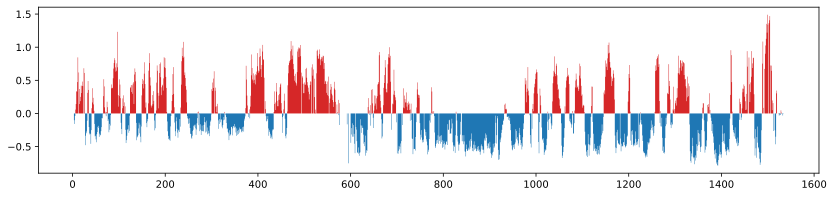

In [90]:
#| label: fig-AB-macaque

import pywt
import matplotlib

pc = 1

# first 3 eigenvectors
cis_eigs = cooltools.eigs_cis(clr, gc_cov, view_df=view_df, n_eigs=3)

# cis_eigs[0] are eigenvalues
# cis_eigs[1] are eigenvectors
eigenvector_track = cis_eigs[1][['chrom','start','end',f'E{pc}']]
  
eigenvector_track_chrX = eigenvector_track.loc[eigenvector_track['chrom'] == 'chrX']
nbins = len(eigenvector_track_chrX)
eigenvector_track_chrX
eX_values = eigenvector_track_chrX[f'E{pc}'].values

f, ax = plt.subplots(figsize=(14, 3))
s = np.arange(len(eX_values))
x = np.dstack((s, s+1)).flatten()
y = np.repeat(eX_values, 2)
ax.fill_between(x, y, 0, where=(y > 0), ec='none', fc='tab:red')
ax.fill_between(x, y, 0, where=(y < 0), ec='none', fc='tab:blue')

In [91]:
# mat = clr.matrix().fetch('chrX')
# mat = mat[~np.isnan(mat)]
# mat.shape

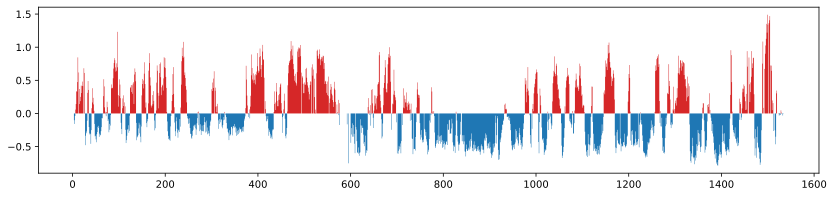

In [92]:
#| label: fig-AB-macaque

import pywt
import matplotlib

pc = 1

# first 3 eigenvectors
cis_eigs = cooltools.eigs_cis(clr, gc_cov, view_df=view_df, n_eigs=3)

# cis_eigs[0] are eigenvalues
# cis_eigs[1] are eigenvectors
eigenvector_track = cis_eigs[1][['chrom','start','end',f'E{pc}']]
  
eigenvector_track_chrX = eigenvector_track.loc[eigenvector_track['chrom'] == 'chrX']
nbins = len(eigenvector_track_chrX)
eigenvector_track_chrX
eX_values = eigenvector_track_chrX[f'E{pc}'].values

f, ax = plt.subplots(figsize=(14, 3))
s = np.arange(len(eX_values))
x = np.dstack((s, s+1)).flatten()
y = np.repeat(eX_values, 2)
ax.fill_between(x, y, 0, where=(y > 0), ec='none', fc='tab:red')
ax.fill_between(x, y, 0, where=(y < 0), ec='none', fc='tab:blue')

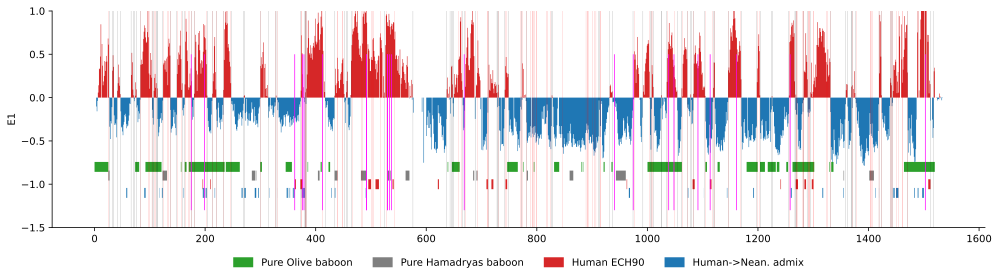

In [199]:
#| label: fig-AB-macaque-with-annot


import pywt
import matplotlib

pc = 1

# first 3 eigenvectors
cis_eigs = cooltools.eigs_cis(clr, gc_cov, view_df=view_df, n_eigs=3)

# cis_eigs[0] are eigenvalues
# cis_eigs[1] are eigenvectors
eigenvector_track = cis_eigs[1][['chrom','start','end',f'E{pc}']]
  
eigenvector_track_chrX = eigenvector_track.loc[eigenvector_track['chrom'] == 'chrX']
nbins = len(eigenvector_track_chrX)
eigenvector_track_chrX
eX_values = eigenvector_track_chrX[f'E{pc}'].values

f, ax = plt.subplots(figsize=(14, 4))
s = np.arange(len(eX_values))
x = np.dstack((s, s+1)).flatten()
y = np.repeat(eX_values, 2)
ax.fill_between(x, y, 0, where=(y > 0), ec='none', fc='tab:red', alpha=1)
ax.fill_between(x, y, 0, where=(y < 0), ec='none', fc='tab:blue', alpha=1)

# ax.fill_between(range(len(eX_values)), eX_values, 0, where=(eX_values > 0), ec='none', fc='tab:red')
# ax.fill_between(range(len(eX_values)), eX_values, 0, where=(eX_values < 0), ec='none', fc='tab:blue')

ax.hlines(np.repeat(-0.8, len(high_olive_rhemac10.start/res)), high_olive_rhemac10.start/res, high_olive_rhemac10.end/res, lw=10, colors='tab:green', capstyle='butt', label='Pure Olive baboon')
ax.hlines(np.repeat(-0.9, len(high_hama_rhemac10.start/res)), high_hama_rhemac10.start/res, high_hama_rhemac10.end/res, lw=10, colors='tab:gray', capstyle='butt', label='Pure Hamadryas baboon')
ax.hlines(np.repeat(-1.0, len(ech90_human_Mmul_10.start/res)), ech90_human_Mmul_10.start/res, ech90_human_Mmul_10.end/res, lw=10, colors='tab:red', capstyle='butt', label='Human ECH90')
ax.hlines(np.repeat(-1.1, len(hum_nean_rhemac10_collapsed.start/res)), hum_nean_rhemac10_collapsed.start/res, hum_nean_rhemac10_collapsed.end/res, lw=10, colors='tab:blue', capstyle='butt', label='Human->Nean. admix')


hum_nean_rhemac10_collapsed

ax.set_ylabel(f'E{pc}')
# ax.set_xticks([]);
# ax.set_yticks([]);
ax.get_subplotspec()
# ax.set_axis_off()





file_name = f"../data/rec_compartments/sperm_e1_100kb_10Mb.csv"
compartments, compartment_edges = parse_compartment_data(file_name)
compartment_edge_1bp = edge_segments(compartment_edges, flank=1)
compartment_edge_1bp.start
ax.vlines(compartment_edge_1bp.start/100000,  -1.5, 1, lw=0.1, color='red')

file_name = f"../data/rec_compartments/sperm_e1_100kb_full.csv"
compartments, compartment_edges = parse_compartment_data(file_name)
compartment_edge_1bp = edge_segments(compartment_edges, flank=1)
compartment_edge_1bp.start
ax.vlines(compartment_edge_1bp.start/100000,  -1.5, 1, lw=0.1, color='black')



coords = gi.gene_labels(sheet.get('cDEG'), assembly='rheMac10')
for chrom, pos, name in coords:
    ax.vlines(pos/100000,  -1.3, 0.5, lw=0.7, color='magenta')

plt.ylim(-1.5, 1)

#plt.xlim(900, 1300)

plt.legend()
sns.move_legend(ax, "upper center", bbox_to_anchor=(0.5, -0.1), ncol=4, frameon=False)

plt.tight_layout()

sns.despine()

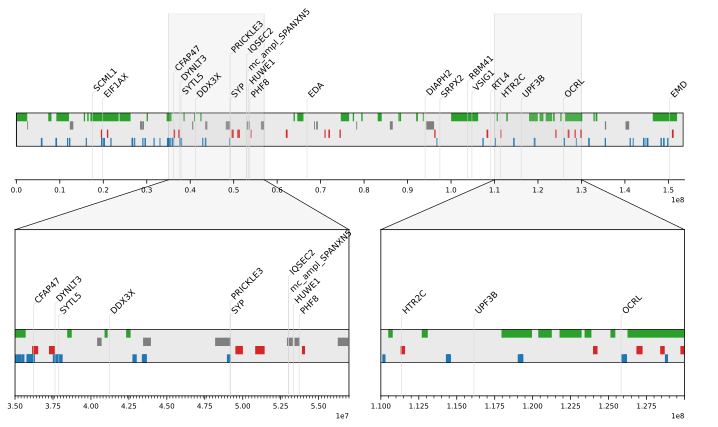

In [193]:
g = gplt.ChromIdeogram('chrX', assembly='rheMac10', ylim=(0, 10), axes_height_inches=3, font_size=4,
                       zoom_height_ratio=1, 
                       # zoom_font_size=5, 
                       zoom_effect_alpha=0.2,
#                       ylim=(0, 10),
                          zooms=[
        (35_000_000, 57_000_000),
        (110_000_000, 130_000_000),
    ]
                      )

g.draw_chromosomes(base=2, height=2)
g.add_labels(gi.gene_labels(sheet.get('cDEG'), assembly='rheMac10'), base=0, min_height=g.ideogram_base+g.ideogram_height+1)
g.add_segments(high_olive_rhemac10[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:green', base=3.5, height=0.5) 
g.add_segments(high_hama_rhemac10[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:gray', base=3, height=0.5) 
g.add_segments(ech90_human_Mmul_10[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:red', base=2.5, height=0.5) 
g.add_segments(hum_nean_rhemac10_collapsed[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:blue', base=2, height=0.5) 
g.add_legend('right')

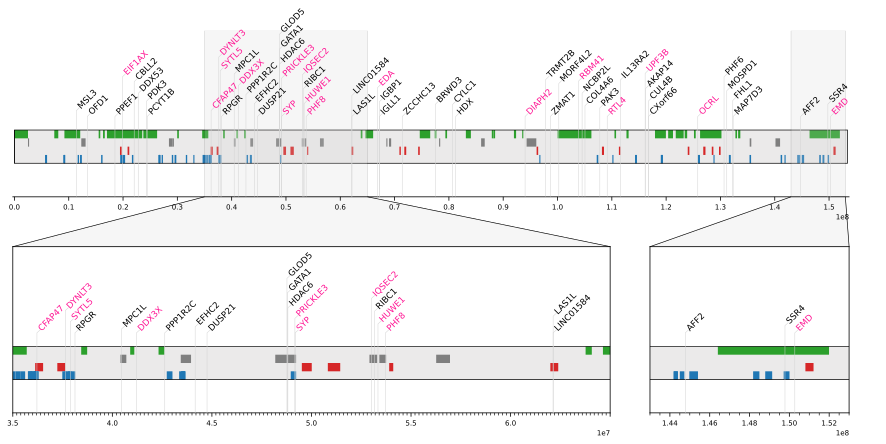

In [192]:
g = gplt.ChromIdeogram('chrX', assembly='rheMac10', ylim=(0, 10), axes_height_inches=3, axes_width_inches=15, font_size=4,
                       zoom_height_ratio=1, 
                       # zoom_font_size=5, 
                       zoom_effect_alpha=0.2,
#                       ylim=(0, 10),
                          zooms=[
        (35_000_000, 65_000_000),
        (143_000_000, 153_000_000),
    ]
                      )

g.draw_chromosomes(base=2, height=2)
g.add_labels(gi.gene_labels(sheet.get('nDEG'), assembly='rheMac10'), base=0, min_height=g.ideogram_base+g.ideogram_height+1, colored=sheet.get('cDEG'))

g.add_segments(high_olive_rhemac10[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:green', base=3.5, height=0.5) 
g.add_segments(high_hama_rhemac10[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:gray', base=3, height=0.5) 
g.add_segments(ech90_human_Mmul_10[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:red', base=2.5, height=0.5) 
g.add_segments(hum_nean_rhemac10_collapsed[['chrom', 'start', 'end']].itertuples(index=False), fc='tab:blue', base=2, height=0.5) 
g.add_legend('right')

In [21]:

import pywt
import matplotlib
from matplotlib.axes import Axes

pc = 1

# first 3 eigenvectors
cis_eigs = cooltools.eigs_cis(clr, gc_cov, view_df=view_df, n_eigs=3)

# cis_eigs[0] are eigenvalues
# cis_eigs[1] are eigenvectors
eigenvector_track = cis_eigs[1][['chrom','start','end',f'E{pc}']]
  
eigenvector_track_chrX = eigenvector_track.loc[eigenvector_track['chrom'] == 'chrX']
nbins = len(eigenvector_track_chrX)
eigenvector_track_chrX
eX_values = eigenvector_track_chrX[f'E{pc}'].values


s = np.arange(len(eX_values))
x = np.dstack((s, s+1)).flatten() * 100_000
y = np.repeat(eX_values, 2)
plot_df = pd.DataFrame(dict(x=x, y=y))
plot_df['chrom'] = 'chrX'

In [22]:
sheet.get('cDEG') << (sheet.get('ech90_regions') | sheet.get('hum_nean_admix')) << sheet.get('ari_relate_AFR') << sheet.get('accel_reg_simiiformes_br')

CFAP47,EDA,HUWE1,PHF8,SCML1,UPF3B
DDX3X,EIF1AX,IQSEC2,PRICKLE3,SRPX2,VSIG1
DIAPH2,EMD,mc_ampl_SPANXN5,RBM41,SYP,
DYNLT3,HTR2C,OCRL,RTL4,SYTL5,


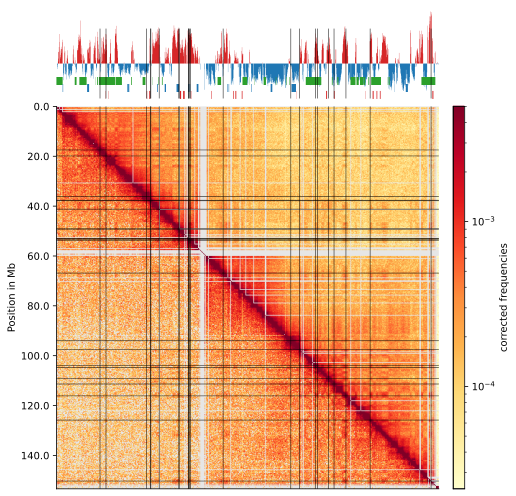

In [23]:
#| label: fig-macaque-hic-matrix

import pywt
import matplotlib

pc = 1

# first 3 eigenvectors
cis_eigs = cooltools.eigs_cis(clr, gc_cov, view_df=view_df, n_eigs=3)

# cis_eigs[0] are eigenvalues
# cis_eigs[1] are eigenvectors
eigenvector_track = cis_eigs[1][['chrom','start','end',f'E{pc}']]
  
eigenvector_track_chrX = eigenvector_track.loc[eigenvector_track['chrom'] == 'chrX']
nbins = len(eigenvector_track_chrX)
eigenvector_track_chrX
eX_values = eigenvector_track_chrX[f'E{pc}'].values

f, ax = plt.subplots(figsize=(7, 7))
# norm = LogNorm(vmax=0.1)
norm = LogNorm(vmax=0.005)

mat = clr.matrix().fetch('chrX')
lower = np.tril(mat, -1)

mat = clr.matrix().fetch('chrX')
base = np.nanmin(mat[np.nonzero(mat)])
_mat = np.log(mat + base) / np.log(base)
mra2 = pywt.mra2(_mat, wavelet='haar')
_mat, decomp = mra2[0], mra2[1]
_mat = base**_mat
upper = np.triu(_mat, 1)

n = len(upper) + 1
ul_mat = np.eye(n)
ul_mat[np.triu_indices(n, 1)] = upper[np.triu_indices(n-1)]
ul_mat[np.tril_indices(n, -1)] = lower[np.tril_indices(n-1)]

masked_array = ul_mat
cmap = matplotlib.cm.YlOrRd
cmap.set_bad('black', alpha=0.1)
im = ax.matshow(masked_array, norm=norm, 
               interpolation='nearest', 
               cmap=cmap)

plt.axis([0,nbins,nbins,0])
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3%", pad=0.2)
plt.colorbar(im, cax=cax, label='corrected frequencies');
ax.set_ylabel('Position in Mb')
yticks = np.array(ax.get_yticks())
yticks, ylabels = zip(*[(y, l) for (y, l) in zip(yticks, (yticks * res + view_df.start[0]) / 1e6) if y < mat.shape[0]])
ax.set_yticks(yticks, ylabels)
ax.xaxis.set_visible(False)
sns.despine()

ax1 = divider.append_axes("top", size="25%", pad=0.05, sharex=ax)
#weights = clr.bins()[:]['weight'].values
#ax1.plot([0,nbins],[0,0],'k',lw=0.25)

s = np.arange(len(eX_values))
x = np.dstack((s, s+1)).flatten()
y = np.repeat(eX_values, 2)
ax1.fill_between(x, y, 0, where=(y > 0), ec='none', fc='tab:red')
ax1.fill_between(x, y, 0, where=(y < 0), ec='none', fc='tab:blue')

ax1.hlines(np.repeat(-0.5, len(high_olive_rhemac10.start/res)), high_olive_rhemac10.start/res, high_olive_rhemac10.end/res, lw=8, colors='tab:green', capstyle='butt')
ax1.hlines(np.repeat(-0.7, len(high_hama_rhemac10.start/res)), high_hama_rhemac10.start/res, high_hama_rhemac10.end/res, lw=8, colors='tab:blue', capstyle='butt')
ax1.hlines(np.repeat(-0.9, len(ech90_human_Mmul_10.start/res)), ech90_human_Mmul_10.start/res, ech90_human_Mmul_10.end/res, lw=8, colors='tab:red', capstyle='butt')
ax1.set_ylabel(f'E{pc}')
ax1.set_xticks([]);
ax1.set_yticks([]);
ax1.get_subplotspec()
ax1.set_axis_off()

# for s, e in zip(olive_pure_segments.start, olive_pure_segments.end):
#     ax.vlines(olive_pure_segments.start/100000, 0, nbins, lw=0.1, color='tab:green')
#     ax.vlines(olive_pure_segments.end/100000, 0, nbins, lw=0.1, cocDEG_geneslor='tab:green')
#     ax.hlines(olive_pure_segments.start/100000, 0, nbins, lw=0.1, color='tab:green')
#     ax.hlines(olive_pure_segments.end/100000, 0, nbins, lw=0.1, color='tab:green')
    
# for s, e in zip(high_hama_rhemac10.start, high_hama_rhemac10.end):
#     ax.vlines(high_hama_rhemac10.start/res, 0, nbins, lw=0.1, color='tab:blue')
#     ax.vlines(high_hama_rhemac10.end/res, 0, nbins, lw=0.1, color='tab:blue')
#     ax.hlines(high_hama_rhemac10.start/res, 0, nbins, lw=0.1, color='tab:blue')
#     ax.hlines(high_hama_rhemac10.end/res, 0, nbins, lw=0.1, color='tab:blue')

# for s, e in zip(ech90_human_Mmul_10.start, ech90_human_Mmul_10.end):
#     ax.vlines(ech90_human_Mmul_10.start/100000, 0, nbins, lw=0.1, color='tab:brown')
#     ax.vlines(ech90_human_Mmul_10.end/100000, 0, nbins, lw=0.1, color='tab:brown')
#     ax.hlines(ech90_human_Mmul_10.start/100000, 0, nbins, lw=0.1, color='tab:brown')
#     ax.hlines(ech90_human_Mmul_10.end/100000, 0, nbins, lw=0.1, color='tab:brown')

#     ax1.vlines(ech90_human_Mmul_10.start/100000,  -1, 1, lw=0.1, color='tab:brown')
#     ax1.vlines(ech90_human_Mmul_10.end/100000,  -1, 1, lw=0.1, color='tab:brown')


# coords = [(tup[1]+tup[2])/2 for name, tup in gi.gene_coord(nDEG_genes, species='macaca_mulatta').items()]
coords = gi.gene_labels(sheet.get('cDEG'), assembly='rheMac10')
for chrom, pos, name in coords:
    ax.vlines(pos/100000, 0, nbins, lw=0.5, color='black')
    ax.hlines(pos/100000, 0, nbins, lw=0.5, color='black')

    ax1.vlines(pos/100000,  -1, 1, lw=0.5, color='black')



plt.tight_layout()

# for i in np.where(np.diff( (cis_eigs[1][cis_eigs[1]['chrom']=='chrX'][f'E{pc}']>0).astype(int)))[0]:
#     ax.plot([0,nbins],[i,i],'k',lw=0.2)
#     ax.plot([i,i],[0,nbins],'k',lw=0.2)
    
#     ax1.plot([i,i],[0, -1],'k',lw=0.2)

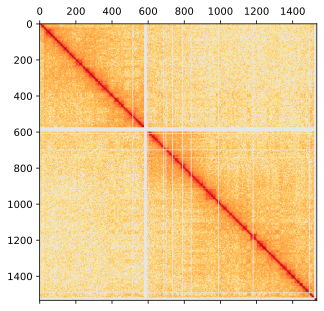

In [24]:
cmap = matplotlib.cm.YlOrRd  
cmap.set_bad('black', alpha=0.1)
f, ax = plt.subplots(figsize=(5, 5))
norm = LogNorm(vmax=0.1)
im = ax.matshow(clr.matrix().fetch('chrX'), norm=norm, cmap=cmap)

## UMAP

In [25]:
umap.plot.output_notebook()

Loading BokehJS ...

In [267]:
np.arange(eX_values.size)

array([   0,    1,    2, ..., 1531, 1532, 1533])

In [285]:
mat = clr.matrix().fetch('chrX')
window_index = np.arange(eX_values.size)
eig_vector = eX_values
eig_vector = eig_vector[~np.isnan(mat).all(axis=1)]
window_index = window_index[~np.isnan(mat).all(axis=1)]
mat = mat[~np.isnan(mat).all(axis=1), :]
#eig_vector = eig_vector[~np.isnan(mat).all(axis=0)]
mat = mat[:, ~np.isnan(mat).all(axis=0)]
mat.shape, eig_vector.shape, window_index.shape

((1473, 1473), (1473,), (1473,))

In [269]:
reducer = umap.UMAP()

In [270]:
scaled_matrix = StandardScaler().fit_transform(mat)

In [271]:
embedding = reducer.fit_transform(scaled_matrix)
embedding.shape

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


(1473, 2)

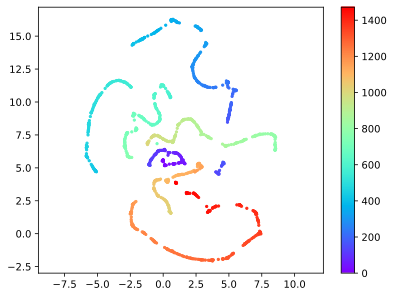

In [272]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=np.arange(0, embedding.shape[0]),
    cmap='rainbow',
    s=5
    # c=[sns.color_palette()[x] for x in penguins.species.map({"Adelie":0, "Chinstrap":1, "Gentoo":2})]
)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar()

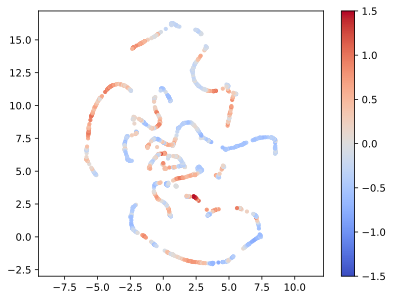

In [273]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=eig_vector,
    cmap='coolwarm',
    s=10
)
#ax.set_aspect('equal', 'datalim')
plt.gca().set_aspect('equal', 'datalim')
cb = plt.colorbar()
plt.clim(-1.5, 1.5)

In [293]:
window_index

array([   3,    4,    5, ..., 1531, 1532, 1533])

In [294]:
100 * np.isin(window_index, np.arange(1500, 1600)).astype(int)

array([  0,   0,   0, ..., 100, 100, 100])

In [307]:
high_hama_win_idx = []
for tup in high_hama_rhemac10.itertuples():
    high_hama_win_idx.extend(list(range(tup.start, tup.end)))
high_hama_win_idx = (np.array(high_hama_win_idx) / 100000).round().astype('int')

high_olive_win_idx = []
for tup in high_olive_rhemac10.itertuples():
    high_olive_win_idx.extend(list(range(tup.start, tup.end)))
high_olive_win_idx = (np.array(high_olive_win_idx) / 100000).round().astype('int')

In [501]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

def get_embedding(n_neighbors, min_dist):
    return umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=2
    ).fit_transform(scaled_matrix)


def plot(ax, ax2, n_neighbors, min_dist):
    
    embedding = get_embedding(n_neighbors, min_dist)
    
    ax.plot(
        embedding[:, 0],
        embedding[:, 1],
        linewidth=0.1,
        color='black',
    )
    ax.scatter(
        embedding[:, 0],
        embedding[:, 1],
        c=window_index,
        cmap='viridis',
        edgecolor='none',
        s= 30 * np.isin(window_index, high_hama_win_idx).astype(int),
        zorder=4,
        alpha=0.6
    )
    ax.scatter(
        embedding[:, 0],
        embedding[:, 1],
        c=window_index,
        cmap='viridis',
        s=0.1,
        zorder=5
    )
    ax.set_aspect('equal', 'datalim')


    
    ax2.plot(
        embedding[:, 0],
        embedding[:, 1],
        linewidth=0.1,
        color='black',

    )    
    ax2.scatter(
        embedding[:, 0],
        embedding[:, 1],

        # c=eig_vector,
        # cmap='coolwarm',
        c=[1 if x > 0 else -1 for x in eig_vector],
        cmap=ListedColormap(['blue', 'red']),
        zorder=5,
        s=0.5
    )
    #ax.set_aspect('equal', 'datalim')
    ax2.set_aspect('equal', 'datalim')

n_neighbors, min_dist = 5, 0.95


fig, axes = plt.subplots(2, 8, figsize=(36, 7))
for ax1, ax2 in zip(axes[0], axes[1]):
    plot(ax1, ax2, n_neighbors, min_dist)

    

    

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finit

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


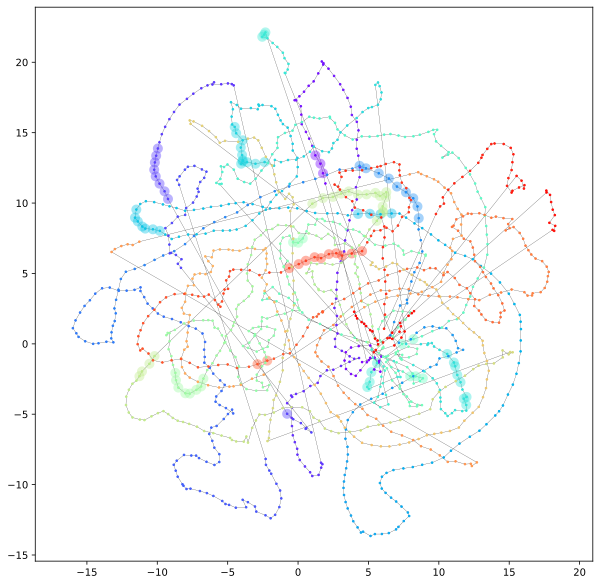

In [476]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap


# embedding = umap.UMAP(
#     n_neighbors=3,
#     min_dist=0.95,
#     n_components=2
# ).fit_transform(scaled_matrix)

embedding = umap.UMAP(
    n_neighbors=3,
    min_dist=0.95,
    n_components=2
).fit_transform(scaled_matrix)


fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.plot(
    embedding[:, 0],
    embedding[:, 1],
    linewidth=0.2,
    color='black',
)
ax.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=window_index,
    cmap='rainbow',
    edgecolor='none',
    s= 100 * np.isin(window_index, high_hama_win_idx).astype(int),
    zorder=4,
    alpha=0.4
)
# ax.scatter(
#     embedding[:, 0],
#     embedding[:, 1],
#     c='green',
#     edgecolor='none',
#     s= 100 * np.isin(window_index, high_olive_win_idx).astype(int),
#     zorder=4,
#     alpha=0.2
# )
ax.scatter(
    embedding[:, 0],
    embedding[:, 1],
    # c=[1 if x > 0 else -1 for x in eig_vector],
    # cmap=ListedColormap(['blue', 'red']),
    c=window_index,
    cmap='rainbow',
    s=3,
    zorder=5
)
#ax.set_aspect('equal', 'datalim')
plt.gca().set_aspect('equal', 'datalim')

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


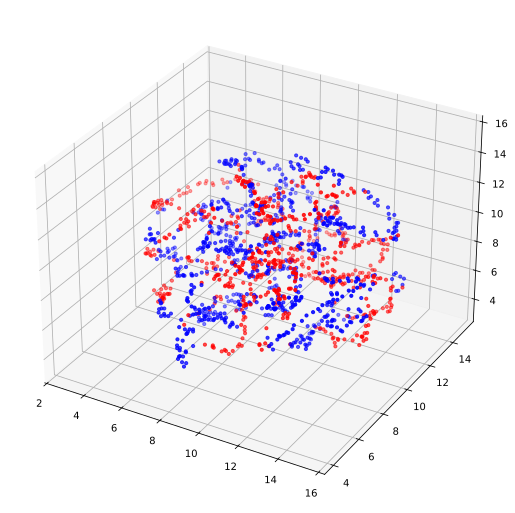

In [474]:
u = umap.UMAP(
    n_neighbors=10,
    min_dist=0.85,
    n_components=3
).fit_transform(scaled_matrix)


fig = plt.figure(figsize=(9, 9))
ax = fig.add_subplot(projection='3d')

ax.scatter(u[:,0], u[:,1], u[:,2], 
    c=[1 if x > 0 else -1 for x in eig_vector],
    cmap=ListedColormap(['blue', 'red']), 
           s=10)
#umap.plot.points(mapper, values=eig_vector, ax=ax, cmap='coolwarm')

# divider = make_axes_locatable(ax)
# cax = divider.append_axes(#'right', 
#                           size='3%',pad=0.1)
# norm=matplotlib.colors.CenteredNorm()
# smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
# cbar = fig.colorbar(smap, ax=ax, cax=cax, cmap=smap) ;

In [156]:
import inspect
inspect.getargspec(umap.plot.diagnostic)

/var/folders/s6/srs8qkh52w1_h32d65z95tth0000gn/T/ipykernel_68468/3890019837.py:2: DeprecationWarning: inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()
  inspect.getargspec(umap.plot.diagnostic)


ArgSpec(args=['umap_object', 'diagnostic_type', 'nhood_size', 'local_variance_threshold', 'ax', 'cmap', 'point_size', 'background', 'width', 'height'], varargs=None, keywords=None, defaults=('pca', 15, 0.8, None, 'viridis', None, 'white', 800, 800))

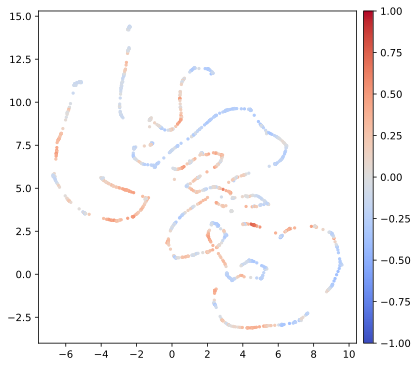

In [231]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

s = ax.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=eig_vector,
    cmap='coolwarm',
    s=5,
    vmin=-2, vmax=2
    # c=[sns.color_palette()[x] for x in penguins.species.map({"Adelie":0, "Chinstrap":1, "Gentoo":2})]
)
#ax.set_aspect('equal', 'datalim')

#umap.plot.points(mapper, values=eig_vector, ax=ax, cmap='coolwarm')
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='3%',pad=0.1)
# norm=matplotlib.colors.CenteredNorm()
# smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
# cbar = fig.colorbar(smap, ax=ax, cax=cax) ;
# fig.colorbar(smap, ax=ax, cax=cax)
fig.colorbar(smap, ax=ax, cax=cax)
#plt.clim(-2, 2)

In [141]:
# mapper = umap.UMAP(
#     n_neighbors=15,
#     min_dist=0.5
# ).fit(scaled_matrix)

# mapper = umap.UMAP(
#     n_neighbors=20,
#     min_dist=0.5
# ).fit(scaled_matrix)

# mapper = umap.UMAP(
#     n_neighbors=10,
#     min_dist=0.90
# ).fit(scaled_matrix)

# mapper = umap.UMAP(
#     n_neighbors=10,
#     min_dist=0.80
# ).fit(scaled_matrix)

mapper = umap.UMAP(
    n_neighbors=10,
    min_dist=0.85,
    n_components=2
).fit(scaled_matrix)

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [142]:
# plt.imshow(mapper.graph_.toarray())
# cmap = matplotlib.cm.YlOrRd  
# cmap.set_bad('black', alpha=0.1)
# f, ax = plt.subplots(figsize=(5, 5))
# norm = LogNorm(vmax=0.1)
# im = ax.matshow(mapper.graph_.toarray(), norm=norm, cmap=cmap)

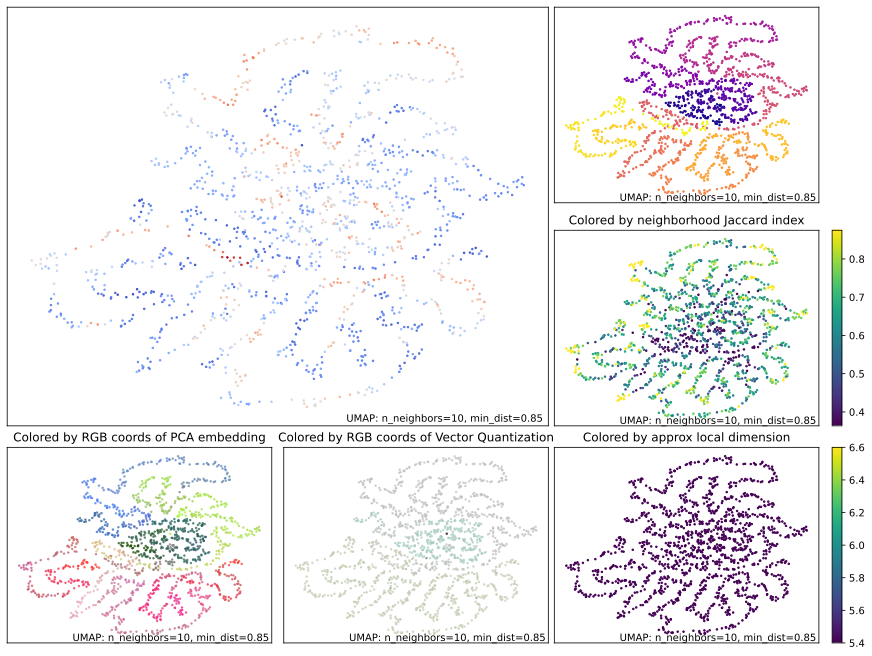

In [192]:
from matplotlib.gridspec import GridSpec

fig = plt.figure(layout="constrained", figsize=(12, 9))

gs = GridSpec(3, 3, figure=fig)

ax = fig.add_subplot(gs[0:2, 0:2])
umap.plot.points(mapper, values=eig_vector, ax=ax, cmap='coolwarm')
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%',pad=0.1)
norm=matplotlib.colors.CenteredNorm()
smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
cbar = fig.colorbar(smap, ax=ax, cax=cax, cmap=smap)

ax = fig.add_subplot(gs[0, 2])
umap.plot.points(mapper, values=np.arange(0, eig_vector.size), ax=ax, cmap='plasma')

ax = fig.add_subplot(gs[1, 2])
umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='neighborhood')

ax = fig.add_subplot(gs[2, 0])
umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='pca')

ax = fig.add_subplot(gs[2, 1])
umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='vq')

ax = fig.add_subplot(gs[2, 2])
cax = umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='local_dim')

#plt.tight_layout()

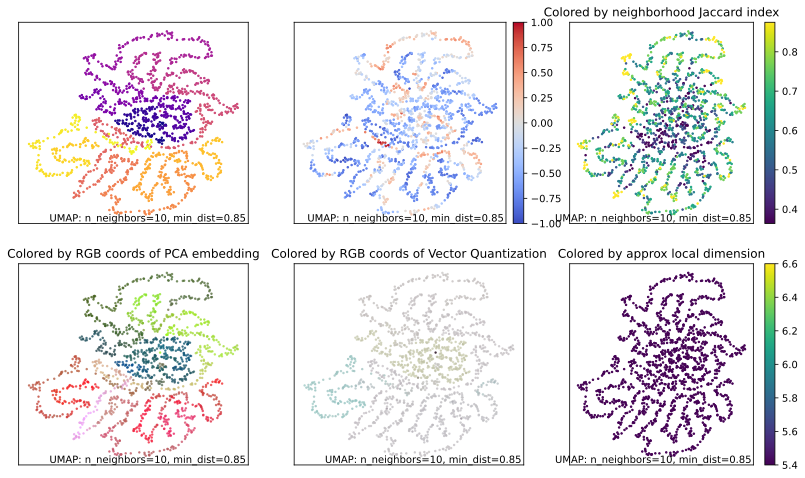

In [175]:
# fig = plt.figure(figsize=(14, 8))
# ax = fig.add_subplot(1, 1, 1)

fig, axes = plt.subplots(2, 3, figsize=(14, 8), width_ratios=[1, 1, 1])
axit = axes.flat

ax = next(axit)
umap.plot.points(mapper, values=np.arange(0, eig_vector.size), ax=ax, cmap='plasma')

ax = next(axit)
umap.plot.points(mapper, values=eig_vector, ax=ax, cmap='coolwarm')
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%',pad=0.1)
norm=matplotlib.colors.CenteredNorm()
smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
cbar = fig.colorbar(smap, ax=ax, cax=cax, cmap=smap)

ax = next(axit)
umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='neighborhood')

ax = next(axit)
umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='pca')

ax = next(axit)
umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='vq')

ax = next(axit)
cax = umap.plot.diagnostic(mapper, ax=ax, diagnostic_type='local_dim')


In [ ]:
umap.plot.connectivity(mapper, show_points=True, edge_cmap='coolwarm');

In [89]:
umap.plot.connectivity(mapper, values=np.arange(0, scaled_matrix.shape[0]), show_points=True, cmap='rainbow')

ValueError: Shape of passed values is (1473, 3), indices imply (1473, 2)

In [90]:
umap.plot.connectivity(mapper, show_points=True, edge_bundling='hammer')

ValueError: Shape of passed values is (1473, 3), indices imply (1473, 2)

In [91]:
umap.plot.connectivity(mapper, values=np.arange(0, scaled_matrix.shape[0]), show_points=True, edge_bundling='hammer', cmap='rainbow')
#umap.plot.points(mapper, values=np.arange(0, scaled_matrix.shape[0]), cmap='rainbow')

ValueError: Shape of passed values is (1473, 3), indices imply (1473, 2)

<Figure size 640x480 with 0 Axes>

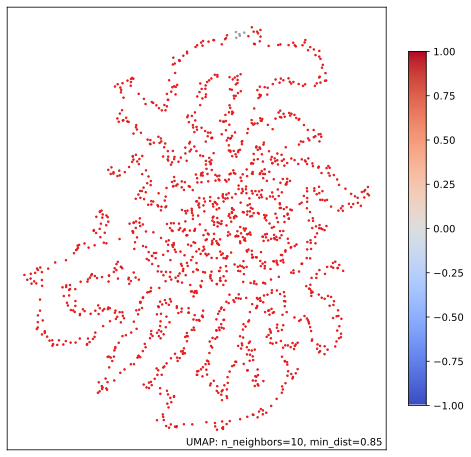

In [144]:
#vals = np.arange(0, scaled_matrix.shape[0])
index = np.arange(0, scaled_matrix.shape[0])
vals = np.repeat(0, index.shape)
for i in range(500, 505):
    vals[i] = 1
#vals = np.array([1 if 500 < x < 1000 else 0 for x in index])

#vals = (.astype('int')

fig = plt.figure()
umap.plot.points(mapper, values=vals, cmap='Set1')

norm=matplotlib.colors.CenteredNorm()
smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)

cbar = fig.colorbar(smap, ax=plt.gca(), fraction=0.1, shrink = 0.8) ;

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


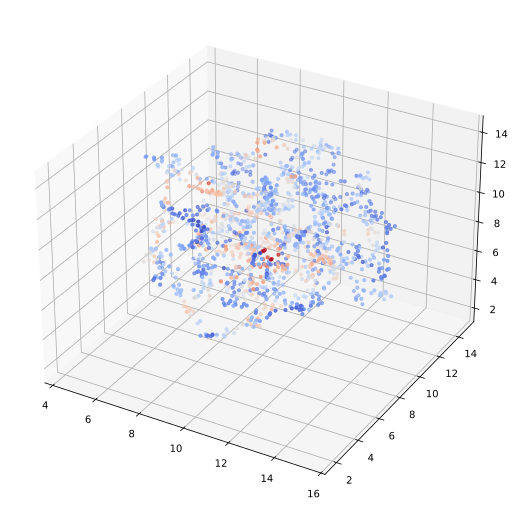

In [110]:
u = umap.UMAP(
    n_neighbors=10,
    min_dist=0.85,
    n_components=3
).fit_transform(scaled_matrix)


fig = plt.figure(figsize=(9, 9))
ax = fig.add_subplot(projection='3d')

ax.scatter(u[:,0], u[:,1], u[:,2], c=eig_vector, cmap='coolwarm', s=10)
#umap.plot.points(mapper, values=eig_vector, ax=ax, cmap='coolwarm')

# divider = make_axes_locatable(ax)
# cax = divider.append_axes(#'right', 
#                           size='3%',pad=0.1)
# norm=matplotlib.colors.CenteredNorm()
# smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
# cbar = fig.colorbar(smap, ax=ax, cax=cax, cmap=smap) ;


In [104]:
u = umap.UMAP(
    n_neighbors=10,
    min_dist=0.85,
    n_components=3
).fit_transform(scaled_matrix)

# fig = plt.figure(figsize=(9, 9))
# ax = fig.add_subplot(projection='3d')

# divider = make_axes_locatable(ax)
# cax = divider.append_axes('right', size='3%',pad=0.1)
# norm=matplotlib.colors.CenteredNorm()
# smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)



fig = plt.figure(figsize=(9, 9))
ax = fig.add_subplot(projection='3d')

ax.scatter(u[:,0], u[:,1], u[:,2], c=eig_vector, cmap='coolwarm', s=100)

divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='3%',pad=0.1)
norm=matplotlib.colors.CenteredNorm()
smap = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
cbar = fig.colorbar(smap, ax=ax, cax=cax) ;


#cbar = ax.colorbar(smap, ax=ax, cax=cax) ;

# ax.scatter(
#     embedding[:, 0],

#     embedding[:, 1],
#     embedding[:, 2],
#     c=np.arange(0, embedding.shape[0]),
#     cmap='rainbow'
#     # c=[sns.color_palette()[x] for x in penguins.species.map({"Adelie":0, "Chinstrap":1, "Gentoo":2})]
# )
# ax.plot(
#     embedding[:, 0],
#     embedding[:, 1],
#     c=np.arange(0, embedding.shape[0]),
#     cmap='rainbow'
#     # c=[sns.color_palette()[x] for x in penguins.species.map({"Adelie":0, "Chinstrap":1, "Gentoo":2})]
# )
plt.gca().set_aspect('equal', 'datalim')

/Users/kmt/miniconda3/envs/cooler/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


ValueError: 'right' is not a valid value for position; supported values are 'lower', 'upper', 'both', 'default', 'none'

Error in callback <function _draw_all_if_interactive at 0x1837871c0> (for post_execute), with arguments args (),kwargs {}:


AttributeError: 'LineCollection' object has no attribute 'do_3d_projection'

AttributeError: 'LineCollection' object has no attribute 'do_3d_projection'

<Figure size 900x900 with 2 Axes>

## Try to make plot recombination rate to see if it is lower in pure regions